In [ ]:
# display the examples evaluated by SemVarEffect

In [1]:
# download the results of dalle-3 which are evaluated by gpt-4-turbo

# examples/dalle-3-lowest-score_testset_all/

Succeed: Total num: 5206, size: 5,764,026,387. OK num: 5206(download 5206 objects).                                                           

average speed 31430000(byte/s)

183.404738(s) elapsed


In [162]:
# read score files
import os
import json
import statistics

def get_id_to_category_dict(score_dir, max_length, given_file=None):
    id_category_dict = {}
    category_id_dict = {}

    for root, subdir, filenames in os.walk(score_dir):
        if root.split("/")[-1] == ".ipynb_checkpoints":
            continue

        for file in filenames:
            path = os.path.join(root, file)
            category = file.split(".")[0]
            
            with open(path, "r", encoding="utf-8") as infile:
                # print (path)
                # if "color" not in path:
                    # continue
                
                if given_file is not None and given_file != file.split(".")[0]:
                    continue
                    
                for line in infile:
                    obj = json.loads(line.strip("\n"))
                    id = obj["id"]
                    if category not in category_id_dict:
                        category_id_dict[category] = []
                    if id not in id_category_dict:
                        id_category_dict[id] = []
                    category_id_dict[category].append(id)
                    id_category_dict[id].append(category)
                    
    return id_category_dict, category_id_dict


def get_id_to_component_score_dict(score_dir, max_length, given_file=None):
    id_score_dict = {}

    for root, subdir, filenames in os.walk(score_dir):
        if root.split("/")[-1] == ".ipynb_checkpoints":
            continue

        for file in filenames:
            path = os.path.join(root, file)
            
            with open(path, "r", encoding="utf-8") as infile:
                # print (path)
                # if "color" not in path:
                    # continue

                if given_file is not None and given_file != file.split(".")[0]:
                    continue
                    
                for line in infile:
                    obj = json.loads(line.strip("\n"))
                    id = obj["id"]
                    
                    index_num_str_list = [str(num) for num in range(max_length)]
                    obj["caption_0"] = [ele for ele in obj["caption_0"] if (ele["image_id"].split("_"))[-1] in index_num_str_list]
                    obj["caption_1"] = [ele for ele in obj["caption_1"] if (ele["image_id"].split("_"))[-1] in index_num_str_list]
                    obj["caption_2"] = [ele for ele in obj["caption_2"] if (ele["image_id"].split("_"))[-1] in index_num_str_list]
                    
                    id_score_dict[id] = {}
                    
                    current_scores_0 = []
                    for num in range(len(obj["caption_0"])):
                        score = obj["caption_0"][num]["score"]
                        current_scores_0.append(score)
                    current_scores_1 = []
                    for num in range(len(obj["caption_1"])):
                        score = obj["caption_1"][num]["score"]
                        current_scores_1.append(score)
                    if "caption_2" in obj:
                        current_scores_2 = []
                        for num in range(len(obj["caption_2"])):
                            score = obj["caption_2"][num]["score"]
                            current_scores_2.append(score)
                    else:
                        current_scores_2 = []
                    
                    id_score_dict[id]["caption_0"] = current_scores_0
                    id_score_dict[id]["caption_1"] = current_scores_1
                    id_score_dict[id]["caption_2"] = current_scores_2
                    
                                        
                    id_score_dict[id]["text_0"] = obj["caption_0"][num]["prompt"]
                    id_score_dict[id]["text_1"] = obj["caption_1"][num]["prompt"]
                    id_score_dict[id]["text_2"] = obj["caption_2"][num]["prompt"]
                    
    return id_score_dict


def get_id_to_component_score_dict_mismatch(score_dir, max_length, given_file=None):
    id_score_dict = {}

    for root, subdir, filenames in os.walk(score_dir):
        if root.split("/")[-1] == ".ipynb_checkpoints":
            continue

        for file in filenames:
            path = os.path.join(root, file)
            
            with open(path, "r", encoding="utf-8") as infile:
                # print (path)
                # if "color" not in path:
                    # continue
                
                if given_file is not None and given_file != file.split(".")[0]:
                    continue
                    
                for line in infile:
                    obj = json.loads(line.strip("\n"))
                    id = obj["id"]
                    
                    index_num_str_list = [str(num) for num in range(max_length)]
                    obj["caption_01"] = [ele for ele in obj["caption_01"] if (ele["image_id"].split("_"))[-1] in index_num_str_list]
                    obj["caption_02"] = [ele for ele in obj["caption_02"] if (ele["image_id"].split("_"))[-1] in index_num_str_list]
                    obj["caption_10"] = [ele for ele in obj["caption_10"] if (ele["image_id"].split("_"))[-1] in index_num_str_list]
                    obj["caption_12"] = [ele for ele in obj["caption_12"] if (ele["image_id"].split("_"))[-1] in index_num_str_list]
                    obj["caption_20"] = [ele for ele in obj["caption_20"] if (ele["image_id"].split("_"))[-1] in index_num_str_list]
                    obj["caption_21"] = [ele for ele in obj["caption_21"] if (ele["image_id"].split("_"))[-1] in index_num_str_list]
                    
                    id_score_dict[id] = {}
                    
                    current_scores_01 = []
                    for num in range(len(obj["caption_01"])):
                        score = obj["caption_01"][num]["score"]
                        current_scores_01.append(score)
                    current_scores_02 = []
                    for num in range(len(obj["caption_02"])):
                        score = obj["caption_02"][num]["score"]
                        current_scores_02.append(score)
                    current_scores_10 = []
                    for num in range(len(obj["caption_10"])):
                        score = obj["caption_10"][num]["score"]
                        current_scores_10.append(score)
                    current_scores_12 = []
                    for num in range(len(obj["caption_12"])):
                        score = obj["caption_12"][num]["score"]
                        current_scores_12.append(score)
                    current_scores_20 = []
                    for num in range(len(obj["caption_20"])):
                        score = obj["caption_20"][num]["score"]
                        current_scores_20.append(score)
                    current_scores_21 = []
                    for num in range(len(obj["caption_21"])):
                        score = obj["caption_21"][num]["score"]
                        current_scores_21.append(score)
                    
                    id_score_dict[id]["caption_01"] = current_scores_01
                    id_score_dict[id]["caption_02"] = current_scores_02
                    id_score_dict[id]["caption_10"] = current_scores_10
                    id_score_dict[id]["caption_12"] = current_scores_12
                    id_score_dict[id]["caption_20"] = current_scores_20
                    id_score_dict[id]["caption_21"] = current_scores_21
                    
                    
    return id_score_dict

In [163]:
import numpy as np
import math

def get_modelname_to_merge_similarity_dict_both(modelname2path_dict, sample_num, threshold, given_file, understand_threshold):
    
    modelname_to_diffscores_dict = {}
        
    for modelname, score_dir in modelname2path_dict.items():
        match_score_dir = score_dir["match"]
        mismatch_score_dir = score_dir["mismatch"]
        modelname_id_category_dict, _ = get_id_to_category_dict(match_score_dir, sample_num, given_file)
        match_modelname_id_score_dict = get_id_to_component_score_dict(match_score_dir, sample_num, given_file)
        # print (modelname, len(match_modelname_id_score_dict.keys()))
        mismatch_modelname_id_score_dict = get_id_to_component_score_dict_mismatch(mismatch_score_dir, sample_num, given_file)
        # print (modelname, len(mismatch_modelname_id_score_dict.keys()))
        ids = list(match_modelname_id_score_dict.keys())
        
        for id in ids:
            for index in range(sample_num):
                s00 = match_modelname_id_score_dict[id]["caption_0"][index]
                s01 = mismatch_modelname_id_score_dict[id]["caption_01"][index]
                s02 = mismatch_modelname_id_score_dict[id]["caption_02"][index]
                s10 = mismatch_modelname_id_score_dict[id]["caption_10"][index]
                s11 = match_modelname_id_score_dict[id]["caption_1"][index]
                s12 = mismatch_modelname_id_score_dict[id]["caption_12"][index]
                s20 = mismatch_modelname_id_score_dict[id]["caption_20"][index]
                s21 = mismatch_modelname_id_score_dict[id]["caption_21"][index]
                s22 = match_modelname_id_score_dict[id]["caption_2"][index]

                avg_ii_score = (s00+s11+s22)/3/100
                real_two_ab_score = math.fabs(s01-s00)/100+math.fabs(s11-s10)/100
                real_two_ac_score = math.fabs(s02-s00)/100+math.fabs(s22-s20)/100
                diff_two_ab_ac = math.fabs(s01-s00)/100+math.fabs(s11-s10)/100-math.fabs(s02-s00)/100-math.fabs(s22-s20)/100
            
                if modelname not in modelname_to_diffscores_dict:
                    modelname_to_diffscores_dict[modelname] = {}

                cat_list = modelname_id_category_dict[id]
                for cat in cat_list:
                    if cat not in modelname_to_diffscores_dict[modelname]:
                        modelname_to_diffscores_dict[modelname][cat] = {}
                    if id not in modelname_to_diffscores_dict[modelname][cat]:
                        modelname_to_diffscores_dict[modelname][cat][id] = {"S00": [], "S11": [],"S22": [], "S01": [], "S02": [], "S10": [], "S12": [], "S20": [], "S21": [], "S": [], "gamma_w": [], "gamma_wo": [], "kappa": [], "prompt_a": [], "prompt_b": [], "prompt_c": []}
                    
                    modelname_to_diffscores_dict[modelname][cat][id]["prompt_a"].append(match_modelname_id_score_dict[id]["text_0"])
                    modelname_to_diffscores_dict[modelname][cat][id]["prompt_b"].append(match_modelname_id_score_dict[id]["text_1"])
                    modelname_to_diffscores_dict[modelname][cat][id]["prompt_c"].append(match_modelname_id_score_dict[id]["text_2"])
                    modelname_to_diffscores_dict[modelname][cat][id]["S00"].append(s00/100)
                    modelname_to_diffscores_dict[modelname][cat][id]["S01"].append(s01/100)
                    modelname_to_diffscores_dict[modelname][cat][id]["S02"].append(s02/100)
                    modelname_to_diffscores_dict[modelname][cat][id]["S10"].append(s10/100)
                    modelname_to_diffscores_dict[modelname][cat][id]["S11"].append(s11/100)
                    modelname_to_diffscores_dict[modelname][cat][id]["S12"].append(s12/100)
                    modelname_to_diffscores_dict[modelname][cat][id]["S20"].append(s20/100)
                    modelname_to_diffscores_dict[modelname][cat][id]["S21"].append(s21/100)
                    modelname_to_diffscores_dict[modelname][cat][id]["S22"].append(s22/100)
                    modelname_to_diffscores_dict[modelname][cat][id]["S"].append(avg_ii_score)
                    modelname_to_diffscores_dict[modelname][cat][id]["gamma_w"].append(real_two_ab_score)
                    modelname_to_diffscores_dict[modelname][cat][id]["gamma_wo"].append(real_two_ac_score)
                    modelname_to_diffscores_dict[modelname][cat][id]["kappa"].append(diff_two_ab_ac)
        
    return modelname_to_diffscores_dict



In [164]:
#######
# matric chart/ heatmap

threshold = -1
given_file = None
understand_threshold = 80
sample_num = 1
# modelname2path_dict = {
#     "dalle3": {"match": "./scores/match/dalle-3-lowest-score_testset_all/output/gpt-4o/", "mismatch": "./scores/mismatch/dalle-3-lowest-score_testset_all/output/gpt-4o/"},
# }
modelname2path_dict = {
    "dalle3": {"match": "./scores/match/dalle-3-lowest-score_testset_all/output/gpt-4-turbo/", "mismatch": "./scores/mismatch/dalle-3-lowest-score_testset_all/output/gpt-4-turbo/"},
}
modelname_to_diffscores_dict = get_modelname_to_merge_similarity_dict_both(modelname2path_dict, sample_num, threshold, given_file, understand_threshold)


In [225]:
import matplotlib.pyplot as plt
from IPython.display import display, Image

def display_images_scores(image_paths, scores):
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))  # 创建一个1行4列的子图
    for i, (path, score) in enumerate(zip(image_paths, scores)):
        img = plt.imread(path)  # 读取图片
        axs[i].imshow(img)  # 显示图片
        axs[i].axis('off')  # 不显示坐标轴
        axs[i].set_title(f"Scores: {score}")  # 在每个图片下方显示分数
    plt.show()  # 显示所有图像


126_v2_72_453
['The mountain in the distance has snowy peak and the hill by the river has green peak.']
['The mountain in the distance has green peak and the hill by the river has snowy peak.']
['The hill by the river has a green peak and the mountain in the distance has a snowy peak.']


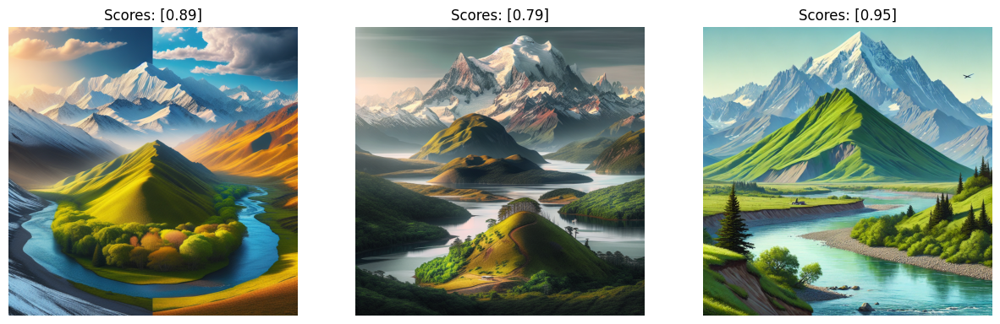

S: 0.8766666666666667 gamma_w: 0.09 gamma_wo: 0.06 kappa: 0.03

297_37_35
['The apple on the tree is ripe and the one on the ground is not.']
['The apple on the ground is ripe and the one on the tree is not.']
['The one on the ground is not ripe and the apple on the tree is.']


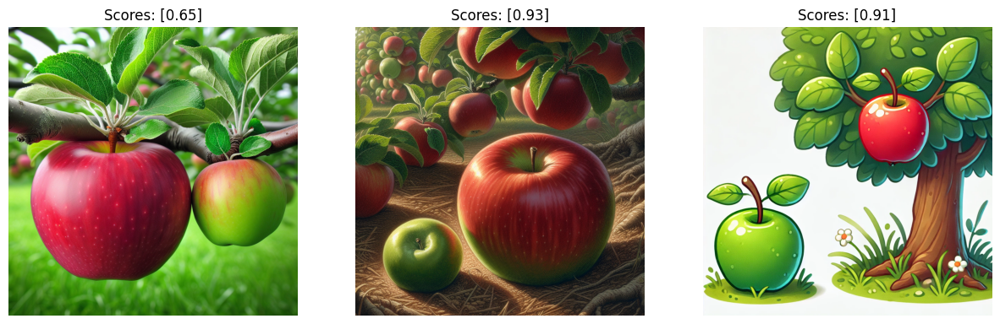

S: 0.83 gamma_w: 0.51 gamma_wo: 0.32 kappa: 0.18999999999999997

279_179_132
['The candle on the left is burning brightly while the one on the right is extinguished.']
['The candle on the left is extinguished while the one on the right is burning brightly.']
['The one on the right is extinguished while the candle on the left is burning brightly.']


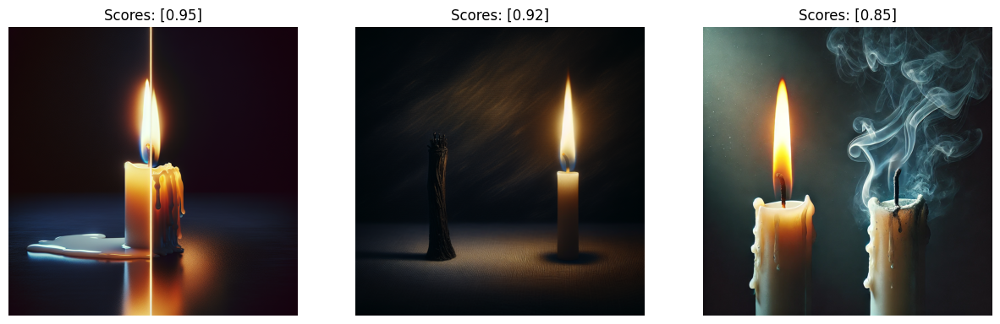

S: 0.9066666666666667 gamma_w: 0.11 gamma_wo: 0.28 kappa: -0.16999999999999998

126_v2_200_560
['The coffee in the mug is black and the tea in the cup is green.']
['The coffee in the mug is green and the tea in the cup is black.']
['The tea in the cup is green and the coffee in the mug is black.']


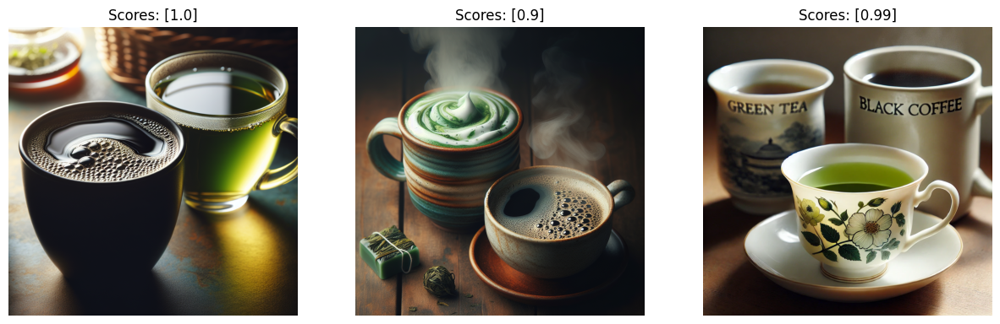

S: 0.9633333333333333 gamma_w: 0.11 gamma_wo: 0.16 kappa: -0.05

100_v1_69_55
['The colorful painting is on the wall and the blank canvas is on the easel.']
['The blank canvas is on the wall and the colorful painting is on the easel.']
['The blank canvas is on the easel and the colorful painting is on the wall.']


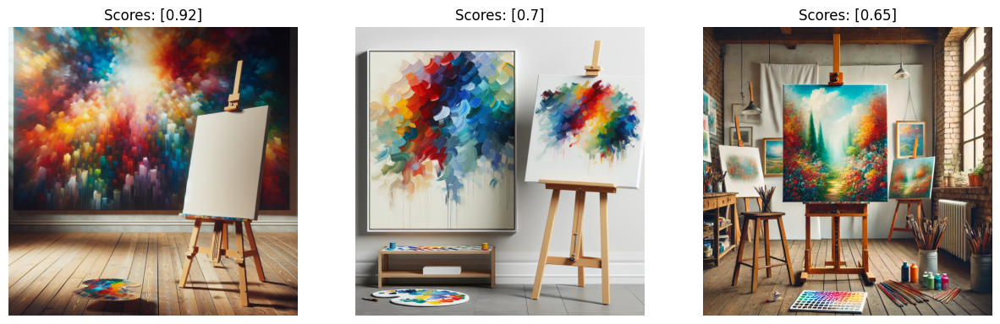

S: 0.7566666666666667 gamma_w: 0.04 gamma_wo: 0.4 kappa: -0.36

341_v2_308_195
['A woman wearing a yellow raincoat with her umbrella in the air and a man wearing a gray coat.']
['A woman wearing a gray coat with her umbrella in the air and a man wearing a yellow raincoat.']
['A man wearing a gray coat and a woman wearing a yellow raincoat with her umbrella in the air.']


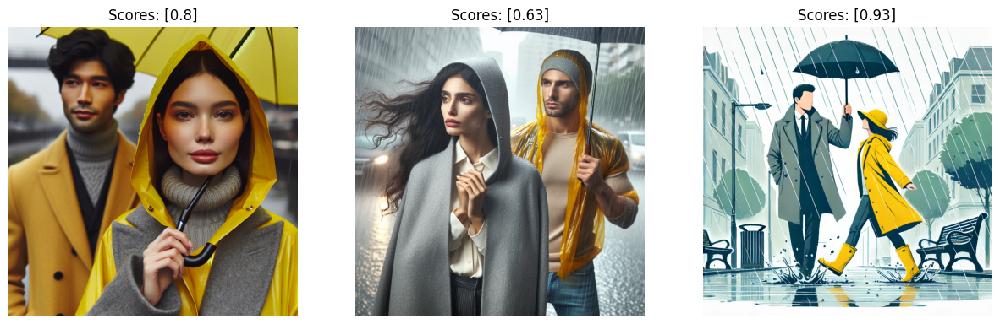

S: 0.7866666666666667 gamma_w: 0.42000000000000004 gamma_wo: 0.25 kappa: 0.17000000000000004

32_299_257
['Chefs in white uniforms with a golden frying pan in their hands.']
['Chefs in golden uniforms with a white frying pan in their hands.']
['In white uniforms with a golden frying pan in their hands, chefs.']


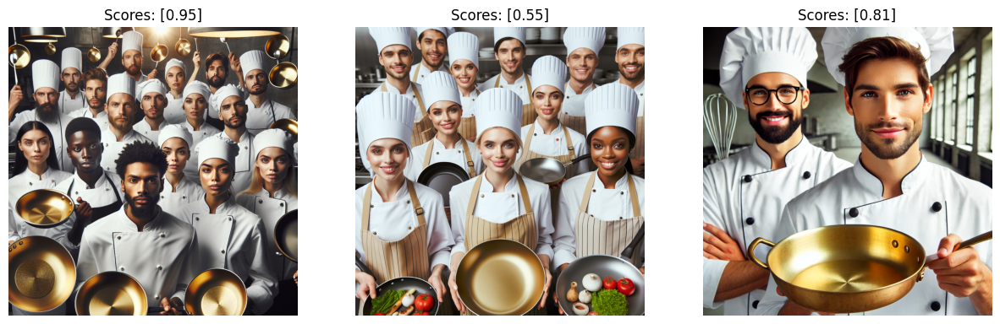

S: 0.77 gamma_w: 0.17 gamma_wo: 0.29000000000000004 kappa: -0.12

107_v2_278_239
['The actor is wearing a black tuxedo and white bow tie.']
['The actor is wearing white tuxedo and black bow tie.']
['The actor is wearing a white bow tie and a black tuxedo.']


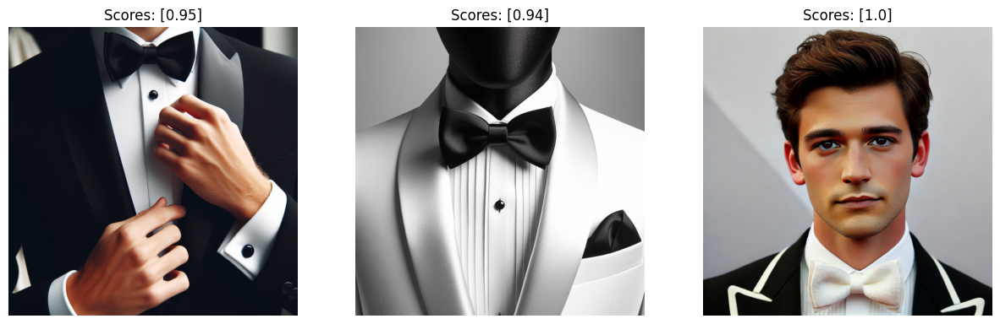

S: 0.9633333333333333 gamma_w: 0.05 gamma_wo: 0.02 kappa: 0.030000000000000002

294_262_180
['The grass is green but the pavement is gray.']
['The grass is gray but the pavement is green.']
['The pavement is gray but the grass is green.']


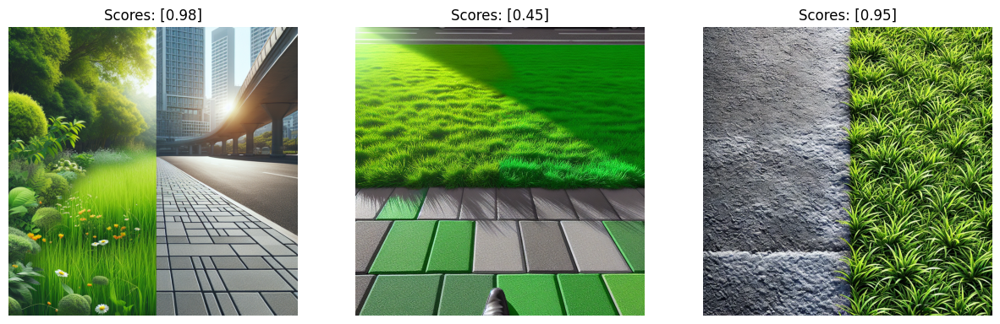

S: 0.7933333333333333 gamma_w: 0.18 gamma_wo: 0.03 kappa: 0.15

126_v1_271_235
['The pen on the desk is blue and the pencil on the table is yellow.']
['The pen on the desk is yellow and the pencil on the table is blue.']
['The pencil on the table is yellow and the pen on the desk is blue.']


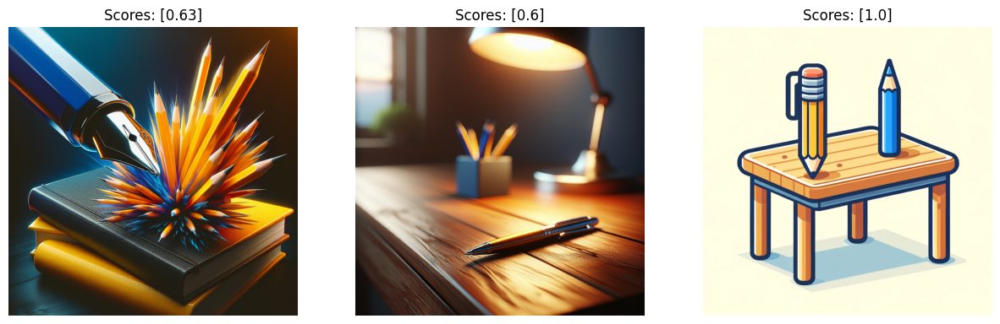

S: 0.7433333333333333 gamma_w: 0.37 gamma_wo: 0.58 kappa: -0.21000000000000002

87_325_51
['The unfiltered water has a cloudy appearance.']
['The water filtered has a clear appearance.']
['The water has a cloudy appearance and is unfiltered.']


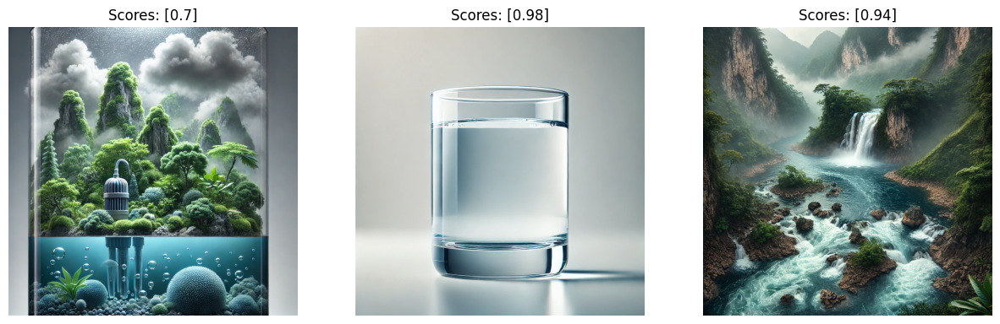

S: 0.8733333333333333 gamma_w: 0.8300000000000001 gamma_wo: 0.62 kappa: 0.21000000000000008

269_225_64
['The apple is red on a brown branch.']
['The apple is brown on a red branch.']
['On a brown branch, the apple is red.']


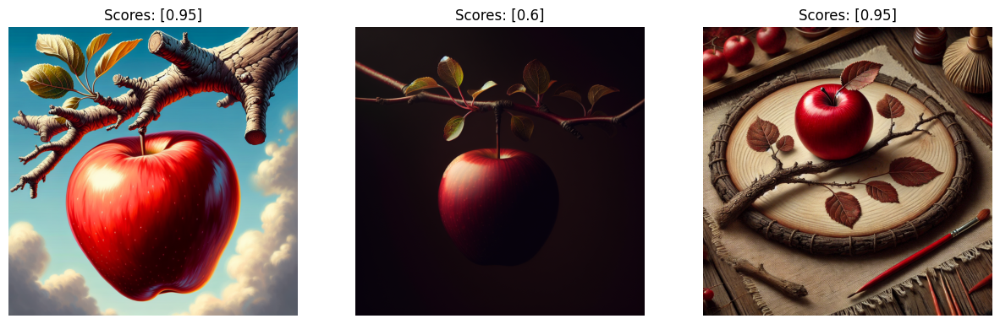

S: 0.8333333333333333 gamma_w: 0.03 gamma_wo: 0.06 kappa: -0.03

261_v2_233_212
['The waiter is wearing a black vest over a white shirt.']
['The waiter is wearing a white vest over a black shirt.']
['A black vest is being worn by the waiter over a white shirt.']


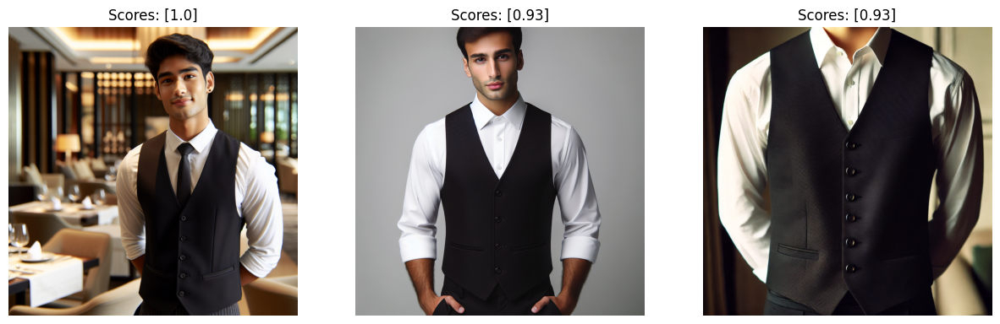

S: 0.9533333333333333 gamma_w: 0.35000000000000003 gamma_wo: 0.07 kappa: 0.28

106_50_49
['The doctor is wearing a white lab coat and black stethoscope.']
['The doctor is wearing a black lab coat and white stethoscope.']
['A white lab coat and a black stethoscope are being worn by the doctor.']


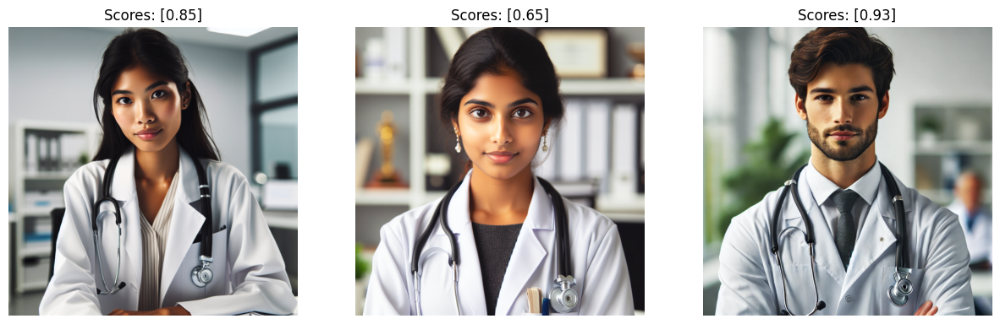

S: 0.81 gamma_w: 0.08 gamma_wo: 0.22 kappa: -0.14

107_v2_169_150
['The scientist is wearing white lab coat and black safety glasses.']
['The scientist is wearing black lab coat and white safety glasses.']
['The scientist is wearing black safety glasses and a white lab coat.']


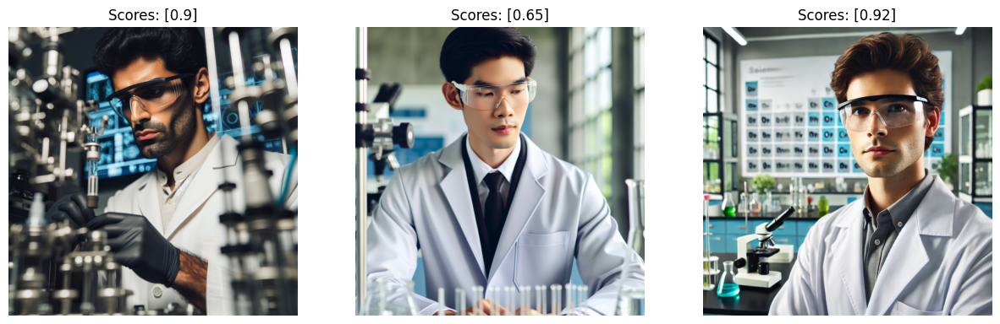

S: 0.8233333333333333 gamma_w: 0.27 gamma_wo: 0.060000000000000005 kappa: 0.21000000000000002

106_30_29
['The scientist is wearing a white lab coat and black gloves.']
['The scientist is wearing a black lab coat and white gloves.']
['The scientist is wearing black gloves and a white lab coat.']


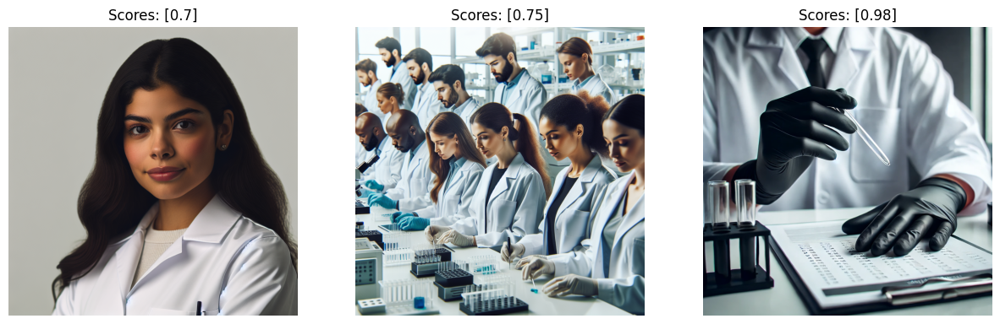

S: 0.81 gamma_w: 0.53 gamma_wo: 0.74 kappa: -0.20999999999999996

35_217_164
['A silver watch is beside a golden necklace.']
['A golden watch is beside a silver necklace.']
['A golden necklace is beside a silver watch.']


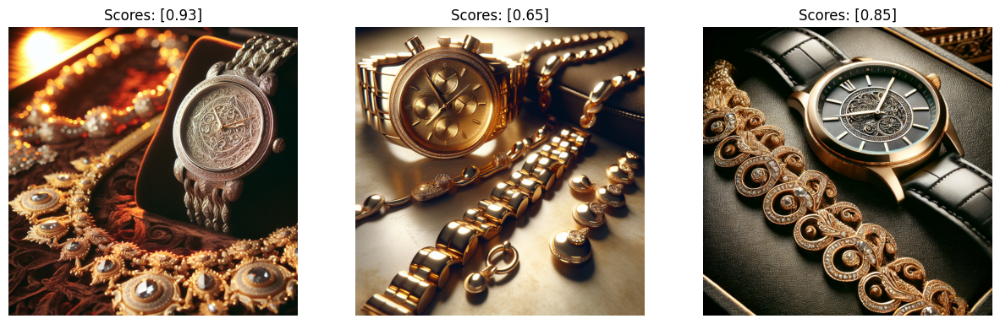

S: 0.81 gamma_w: 0.37 gamma_wo: 0.41000000000000003 kappa: -0.04000000000000001

109_v2_4_2
['The doctor is wearing a green scrubs and white lab coat.']
['The doctor is wearing a white scrubs and green lab coat.']
['The doctor is wearing a white lab coat and green scrubs.']


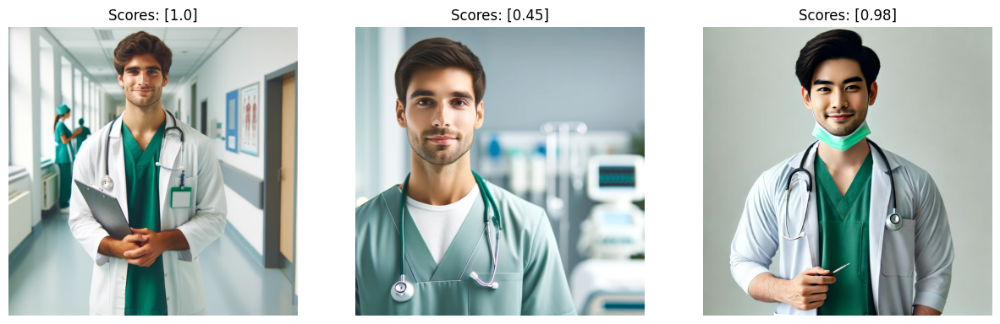

S: 0.81 gamma_w: 0.35 gamma_wo: 0.1 kappa: 0.25

109_v2_86_73
['The writer is wearing a gray sweater and blue jeans.']
['The writer is wearing blue sweater and gray jeans.']
['The writer is wearing blue jeans and a gray sweater.']


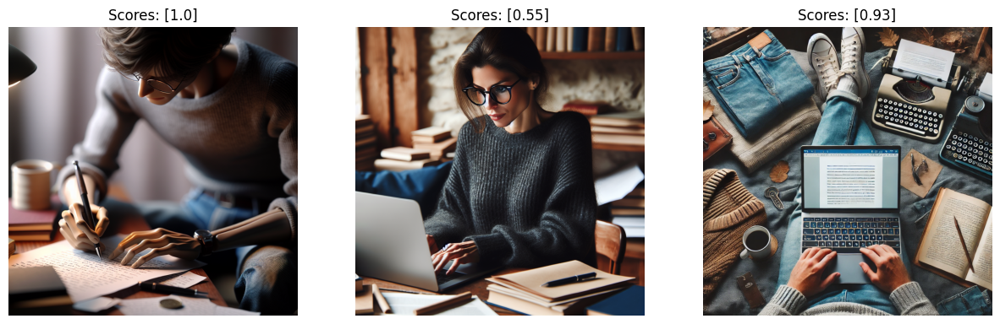

S: 0.8266666666666667 gamma_w: 0.37 gamma_wo: 0.12000000000000001 kappa: 0.25

105_20_226
['Fresh green salad with crisp red tomatoes.']
['Crisp red salad with fresh green tomatoes.']
['Crisp red tomatoes with fresh green salad.']


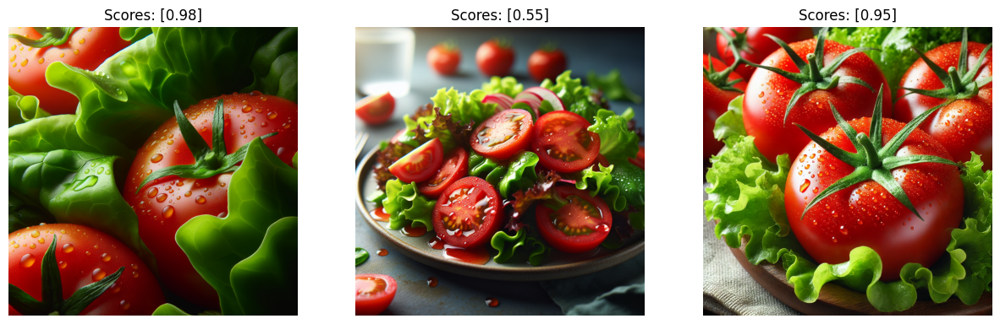

S: 0.8266666666666667 gamma_w: 0.05 gamma_wo: 0.26 kappa: -0.21000000000000002

105_69_256
['There is a huge blue whale with a tiny orange clownfish.']
['There is a tiny orange whale with a huge blue clownfish.']
['There is a tiny orange clownfish with a huge blue whale.']


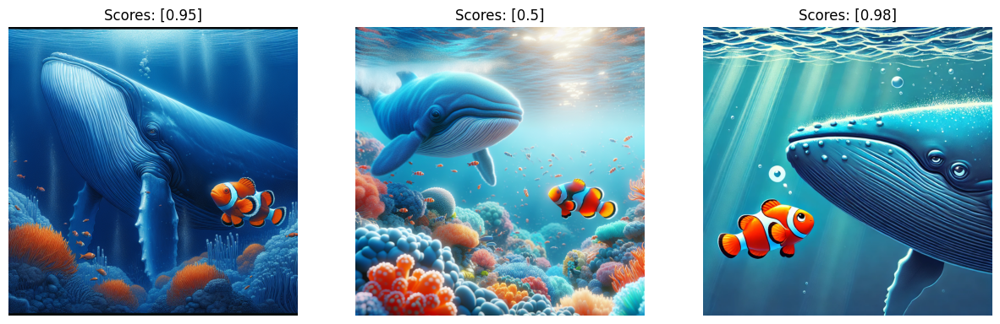

S: 0.81 gamma_w: 0.35 gamma_wo: 0.07 kappa: 0.27999999999999997

30_267_174
['A green apple is on top of a yellow banana.']
['A yellow apple is on top of a green banana.']
['A yellow banana is beneath a green apple.']


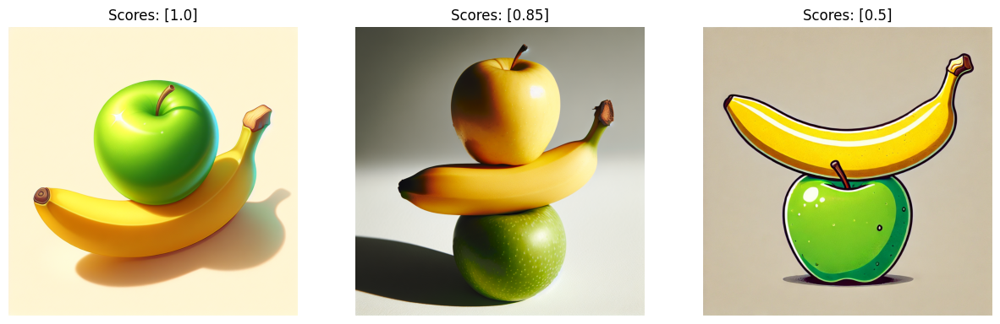

S: 0.7833333333333333 gamma_w: 0.6 gamma_wo: 0.55 kappa: 0.04999999999999993

391_v2_304_245
['The musician wears a polka dot bowtie over a white dress shirt with a collar.']
['The musician wears a white bowtie over a polka dot dress shirt with a collar.']
['Over a white dress shirt with a collar, the musician wears a polka dot bowtie.']


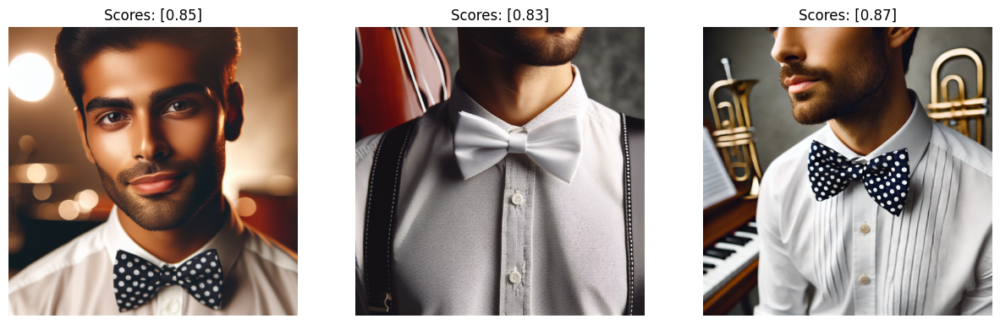

S: 0.85 gamma_w: 0.48 gamma_wo: 0.22999999999999998 kappa: 0.24999999999999994

391_v2_389_318
['The skater wears a denim vest over a graphic t-shirt with a round neck collar.']
['The skater wears a graphic vest over a denim t-shirt with a round neck collar.']
['A denim vest is worn by the skater over a graphic t-shirt with a round neck collar.']


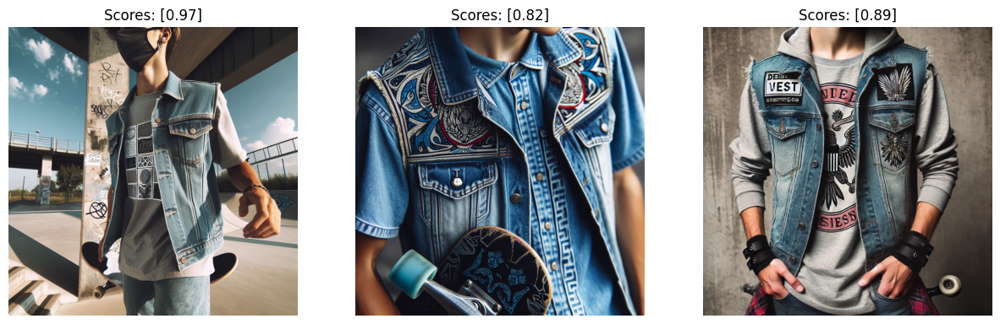

S: 0.8933333333333333 gamma_w: 0.2 gamma_wo: 0.13 kappa: 0.07

117_204_167
['The colorful painting is on the wall and the black and white photograph is on the table.']
['The black and white painting is on the wall and the colorful photograph is on the table.']
['The black and white photograph is on the table and the colorful painting is on the wall.']


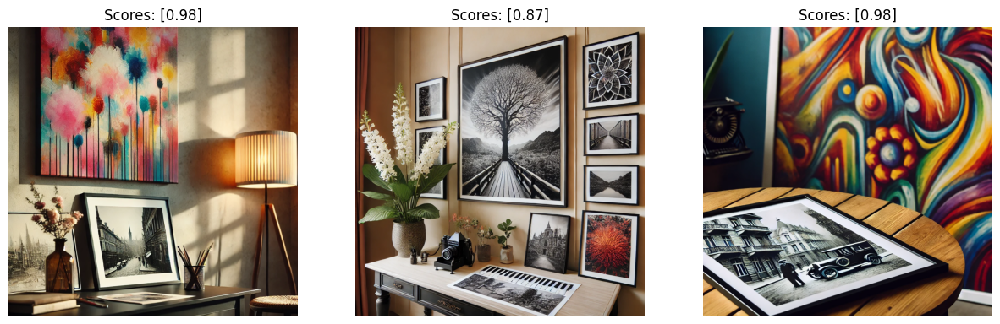

S: 0.9433333333333332 gamma_w: 0.33 gamma_wo: 0.06 kappa: 0.27

117_395_316
['The purple grape is on the plate and the green apple is in the basket.']
['The green grape is on the plate and the purple apple is in the basket.']
['The green apple is in the basket and the purple grape is on the plate.']


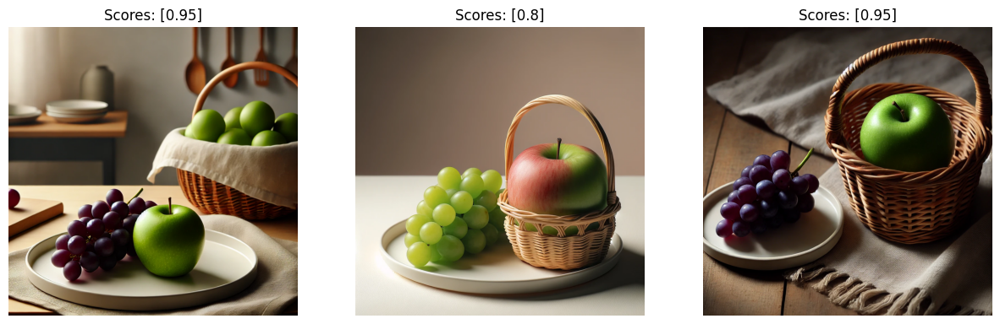

S: 0.9 gamma_w: 0.4 gamma_wo: 0.37 kappa: 0.030000000000000027

107_v2_138_123
['The pilot is wearing blue aviator sunglasses and white gloves.']
['The pilot is wearing white aviator sunglasses and blue gloves.']
['The pilot is wearing white gloves and blue aviator sunglasses.']


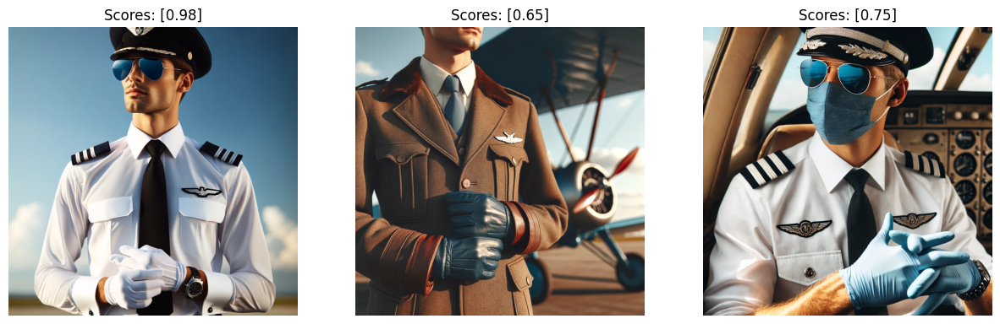

S: 0.7933333333333333 gamma_w: 0.5800000000000001 gamma_wo: 0.36 kappa: 0.22000000000000008

106_290_257
['The construction worker is wearing a yellow hard hat and orange safety vest.']
['The construction worker is wearing a orange hard hat and yellow safety vest.']
['The construction worker is wearing an orange safety vest and a yellow hard hat.']


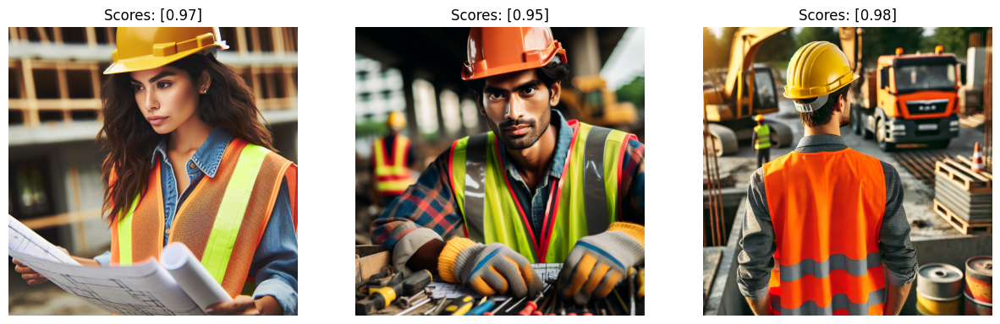

S: 0.9666666666666667 gamma_w: 0.32 gamma_wo: 0.05 kappa: 0.27



IndexError: list index out of range

In [228]:
def show_examples_category(name, cat, start, end):
    ids = list(modelname_to_diffscores_dict[name][cat].keys())
    for id_idx in range(start, end):
        id = ids[id_idx]
        for i in range(len(modelname_to_diffscores_dict[name][cat][id]["S"])):
            image_id_a = id + "_a_" + str(i)
            image_id_b = id + "_b_" + str(i)
            image_id_c = id + "_c_" + str(i)
            image_path_a = "./examples/dalle-3-lowest-score_testset_all/images/" + cat + "/" + image_id_a + ".png"
            image_path_b = "./examples/dalle-3-lowest-score_testset_all/images/" + cat + "/" + image_id_b + ".png"
            image_path_c = "./examples/dalle-3-lowest-score_testset_all/images/" + cat + "/" + image_id_c + ".png"
            image_paths = [image_path_a, image_path_b, image_path_c]

            scores = modelname_to_diffscores_dict[name][cat][id]
            S00 = scores["S00"]
            S11 = scores["S11"]
            S22 = scores["S22"]
            S_list = [S00, S11, S22]
            
            S = scores["S"][0]
            gamma_w = scores["gamma_w"][0]
            gamma_wo = scores["gamma_wo"][0]
            kappa = scores["kappa"][0]
            
            if S > 0.7 and kappa < 0.3:
            # if S < 0.8 and kappa > 0.2:
            # if S < 0.8 and kappa < 0.2:
            # if kappa >= 0.2:
            # if kappa < 0.3:
                print (id)
                print (modelname_to_diffscores_dict[name][cat][id]["prompt_a"])
                print (modelname_to_diffscores_dict[name][cat][id]["prompt_b"])
                print (modelname_to_diffscores_dict[name][cat][id]["prompt_c"])
                display_images_scores(image_paths, S_list)
                print ("S:", S, "gamma_w:", gamma_w, "gamma_wo:", gamma_wo, "kappa:", kappa)
                print ()
                
    
name = "dalle3"
cat = "color"
start = 0
end = 51
show_examples_category(name, cat, start, end)